# GA DSIF 11 Capstone Project:

# Dance Move Classifier (Originality Never Dies) (Part 4)


## Lua Yeow Wen
---

## Demo

### Import Libraries

In [1]:
# Standard Library Imports
import os
import time

# Data Handling and Visualization
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import imageio

# Machine Learning and Neural Network Libraries
from tensorflow.keras.models import Sequential, load_model
from tensorflow.keras.layers import LSTM, GRU, Dense, Dropout
from tensorflow.keras.optimizers import Adam, SGD
from tensorflow.keras.callbacks import TensorBoard
from tensorflow.keras.utils import to_categorical
import keras_tuner as kt
from sklearn.metrics import classification_report, multilabel_confusion_matrix, accuracy_score
from sklearn.model_selection import train_test_split

from tensorflow.keras.callbacks import EarlyStopping

# Computer Vision Libraries
import cv2
import mediapipe as mp

# IPython Display Tools
from IPython.display import Image, display

### Define File Paths

In [2]:
# Define file paths
current_directory = os.getcwd() # get current directory so that it is portable to other users
dataset_numpy_path = os.path.join(current_directory, "dataset_numpy")
moves_df_path = current_directory
save_model_path= os.path.join(current_directory, "models")
predict_result_path= os.path.join(current_directory, "predict_result")

### Moves to be Detected

In [3]:
# Moves that we try to detect
moves = np.array(['jackhammer', 'handhop', 'cc'])


### Create Labels for the Moves

In [4]:
label_map = {label:num for num, label in enumerate(moves)}

## Demo with GRU Model DO

In [5]:
# Define the path where the model is saved
model_file = os.path.join(save_model_path, "GRU Model DO.keras")

# Load the model
model = load_model(model_file)

# MediaPipe setup
mp_pose = mp.solutions.pose
pose = mp_pose.Pose()

# Drawing specifications (as in process_video function)
mp_drawing = mp.solutions.drawing_utils
landmark_drawing_spec = mp_drawing.DrawingSpec(color=(245, 117, 66), thickness=2, circle_radius=2)
connection_drawing_spec = mp_drawing.DrawingSpec(color=(245, 66, 230), thickness=2, circle_radius=2)

# Define video paths and open the video file
predict_video_path = os.path.join(current_directory, "predict_video")
video_file = os.path.join(predict_video_path, "h1.mp4")
cap = cv2.VideoCapture(video_file)

# Initialize a list to store the processed frames
frames = []

while cap.isOpened():
    ret, frame = cap.read()
    if not ret:
        break

    frame = cv2.resize(frame, (int(frame.shape[1] * 0.5), int(frame.shape[0] * 0.5)))

    # Convert the frame to RGB
    frame_rgb = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)

    # Process the frame for pose landmarks
    results = pose.process(frame_rgb)

    # Check if landmarks are detected and extract required landmarks
    if results.pose_landmarks:
        landmarks = results.pose_landmarks.landmark
        selected_landmarks = np.array([(landmarks[idx].x, landmarks[idx].y, landmarks[idx].z, landmarks[idx].visibility)
                                       for idx in [0, 9, 10, 12, 14, 16, 11, 13, 15, 24, 26, 28, 23, 25, 27]])

        # Reshape for the model
        processed_frame = np.repeat(selected_landmarks.flatten().reshape(1, 60), 60, axis=0)
        processed_frame = processed_frame.reshape(1, 60, 60)

        # Make prediction
        prediction = model.predict(processed_frame)

        # Get the predicted class and probability
        predicted_class = np.argmax(prediction, axis=1)
        probability = np.max(prediction, axis=1)

        # Draw landmarks (as in process_video function)
        mp_drawing.draw_landmarks(
            frame,
            results.pose_landmarks,
            mp_pose.POSE_CONNECTIONS,
            landmark_drawing_spec,
            connection_drawing_spec)

        # Display the result and probability (with adjusted font size)
        cv2.putText(frame, f"Predicted: {moves[predicted_class[0]]}, Prob: {probability[0]:.2f}",
                    (10, 30),
                    cv2.FONT_HERSHEY_SIMPLEX,
                    0.75,  # Adjusted font scale (75% of the original size)
                    (255, 255, 255),  # Font color
                    2,  # Thickness
                    cv2.LINE_AA)

    # Convert the frame to RGB for GIF and add to the list
    frame_rgb = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
    frames.append(frame_rgb)

    cv2.imshow("Prediction", frame)

    # Exit on pressing 'q'
    if cv2.waitKey(1) & 0xFF == ord('q'):
        break

cap.release()
pose.close()
cv2.destroyAllWindows()

# Save the frames as a GIF
gif_path = os.path.join(predict_result_path, "output.gif")
imageio.mimsave(gif_path, frames, fps=10)

1/1 [==============================] - 0s 34ms/step


### Prediction for Handhop

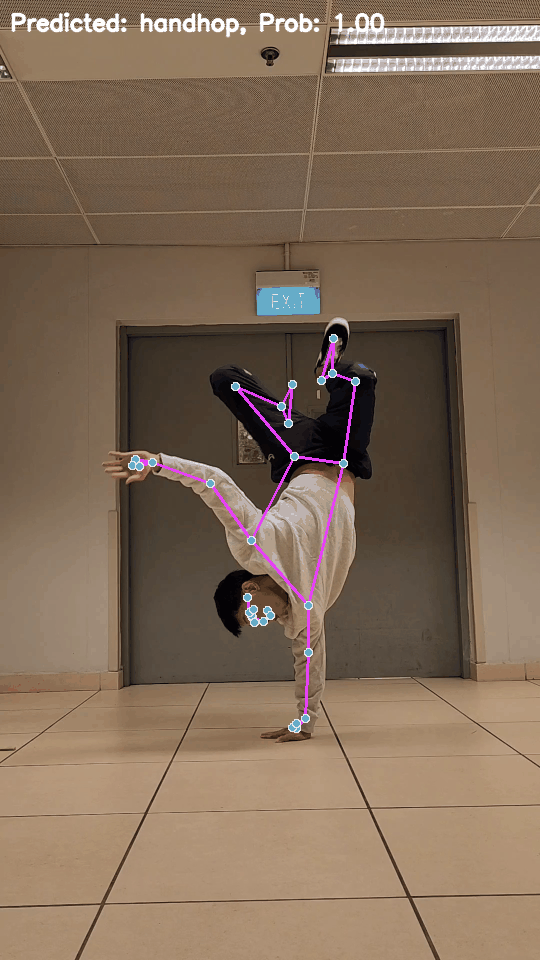

In [6]:
# Display the GIF in the notebook
display(Image(filename=gif_path))